In [ ]:
%load_ext autoreload
%autoreload 2

import scanpy as sc
import yaml
import json
import os
import sys
sys.path.append('../')
sys.path.append('../hovernet')
sys.path.append('../hedest')

PATH = '/home/luca/Documents/data/'
# '/cluster/CBIO/data1/lgortana/'
# '/home/luca/Documents/data_CBIO/'
# '/home/luca/Documents/data/'

/home/luca/anaconda3/envs/plugin-env/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


# Data information

In [8]:
#load adata
adata_name = 'CytAssist_11mm_FFPE_Human_Ovarian_Carcinoma'
data_path = os.path.join(PATH, adata_name)
path_ST_adata = os.path.join(data_path, 'ST')
adata = sc.read_visium(path_ST_adata) #read_visium or read_h5ad

#image path
image_path = os.path.join(data_path, 'tif/CytAssist_11mm_FFPE_Human_Ovarian_Carcinoma_tissue_image.tif')

/home/luca/anaconda3/envs/plugin-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/luca/anaconda3/envs/plugin-env/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


# Segmentation

If you already have segmentation infos inside a json file, please go directly to [Step 3 - Load data](#load_data). If you need to perform segmentation, please follow all the steps.

## Step 1 - Create mask

In [ ]:
from hovernet.mask_utils import make_auto_mask

mask = make_auto_mask(image_path, mask_level=3, save=os.path.join(data_path, 'mask/CytAssist_FFPE_Sagittal_Mouse_Brain_tissue_image.png'))

## Step 2 - HoverNet Segmentation

Now that you have you own mask and the high-resolution WSI, you need to run the run_hovernet.sh. Your command should look like this :

In [ ]:
python ../hover_net/run_infer.py \
    --gpu='0,1' \
    --nr_types=0 \
    --type_info_path=../hover_net/type_info.json \
    --model_mode=fast \
    --model_path=/cluster/CBIO/data1/lgortana/pretrained/seg_classif/hovernet_fast_pannuke_type_tf2pytorch.tar \
    wsi \
    --input_dir=/cluster/CBIO/data1/lgortana/Xenium_V1_humanLung_Cancer_FFPE/tif/ \
    --output_dir=/cluster/CBIO/data1/lgortana/Xenium_V1_humanLung_Cancer_FFPE/seg_json/ \
    --input_mask_dir=data/CytAssist_11mm_FFPE_Human_Ovarian_Carcinoma/mask/lvl3/ \

## Step 3 - Load data <a id="load_data"></a>

In [4]:
#load image infos
json_path = os.path.join(data_path, 'seg_json/pannuke_fast_mask_lvl3.json')
with open(json_path) as json_file:
    hovernet_dict = json.load(json_file)

# Load the dictionary with the types and colors
dict_types_colors_path = "../references/colors_hovernet.yaml"
with open(dict_types_colors_path, 'r') as file:
    dict_types_colors = yaml.load(file, Loader=yaml.FullLoader)["pannuke"]

In [5]:
ct_list = [item[0] for item in list(dict_types_colors.values())]

In [ ]:
from hedest.postseg import count_cell_types
count_cell_types(hovernet_dict, ct_list)

,neopla,connec,necros,nolabe,no-neo,inflam
0,252556,62523,3720,2794,4624,25876


# Segmentation analysis
## Plot slide and segmented nuclei

In [ ]:
from hedest.postseg import StdVisualizer

plotter = StdVisualizer(image_path=image_path,
                        seg_dict=hovernet_dict,
                        color_dict=dict_types_colors)

No Visium data provided. You won't be able to plot Visium spots.


TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


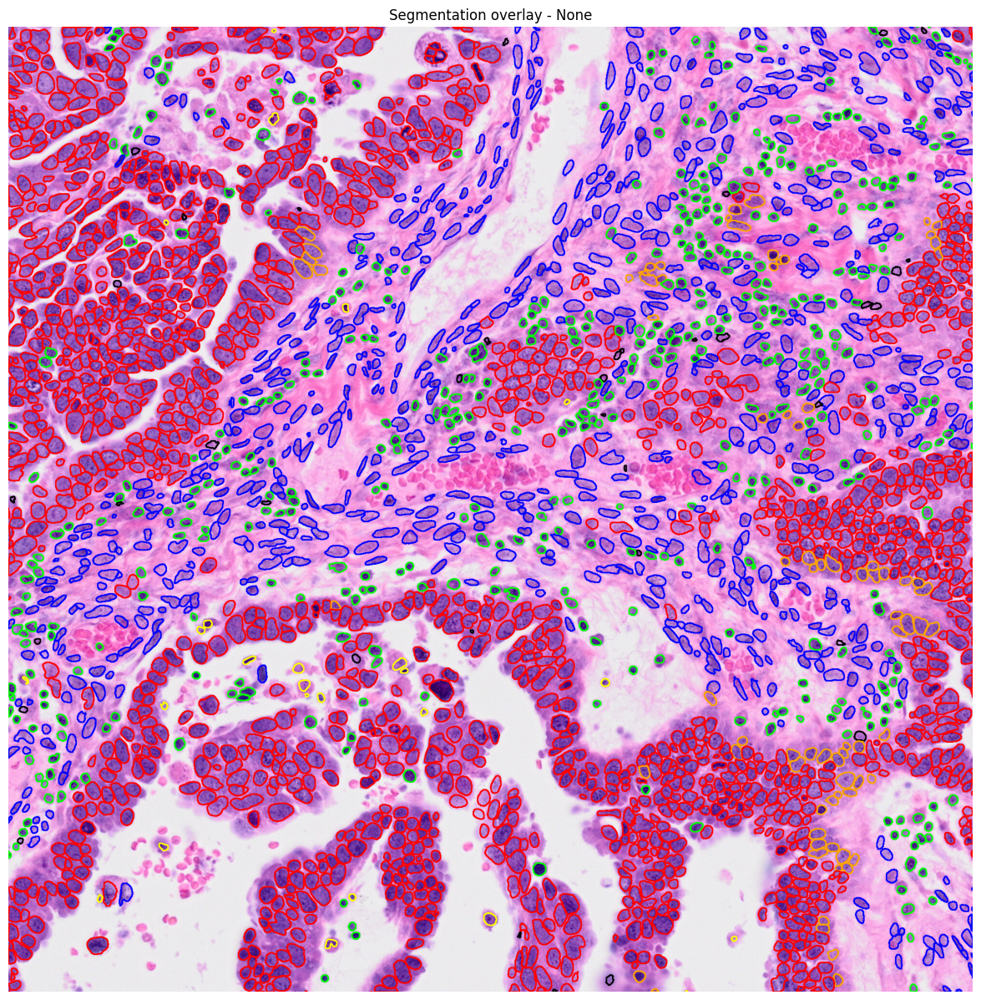

In [13]:
window = ((15000, 4000), (2000, 2000))
plotter.plot_seg(window=window, show_visium=False)

In [ ]:
from hedest.postseg import StdVisualizer

plotter = StdVisualizer(image_path, 
                        adata, 
                        adata_name, 
                        dict_cells = json_path,
                        dict_types_colors=dict_types_colors)

Visium data found.


TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


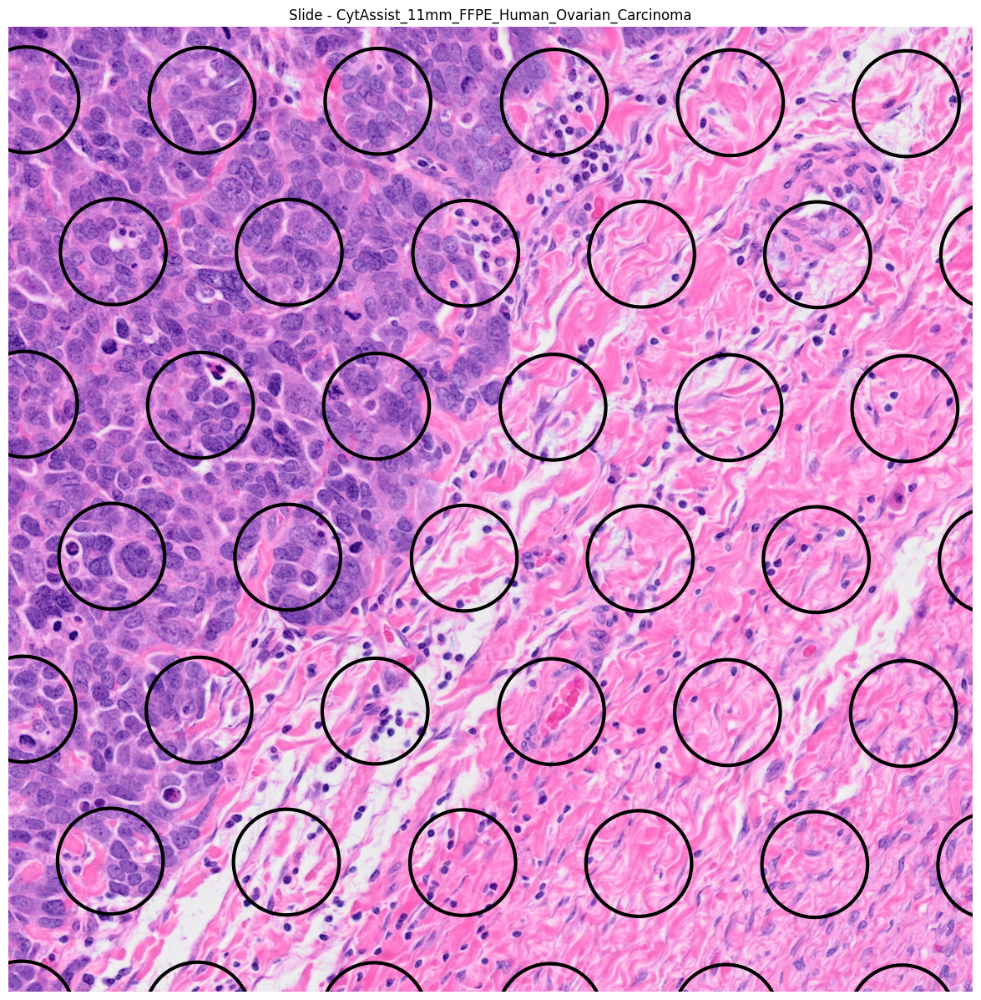

In [13]:
window = ((25000, 4000), (2000, 2000))
plotter.plot_slide(window, show_visium=True)

Randomly selected spot_id: TAATTGATGCGAGTCC-1


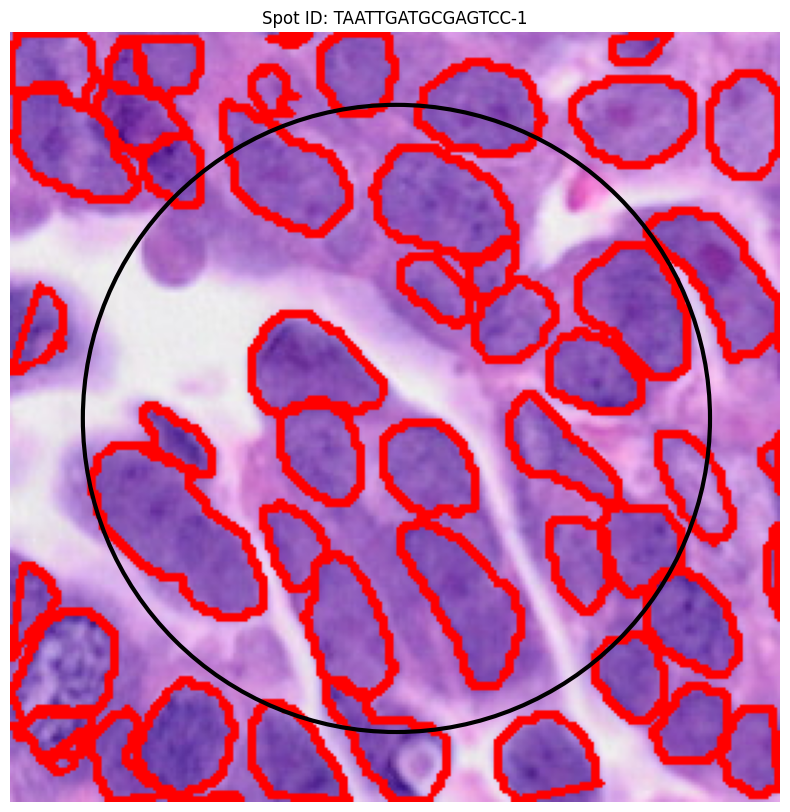

In [14]:
plotter.plot_specific_spot()

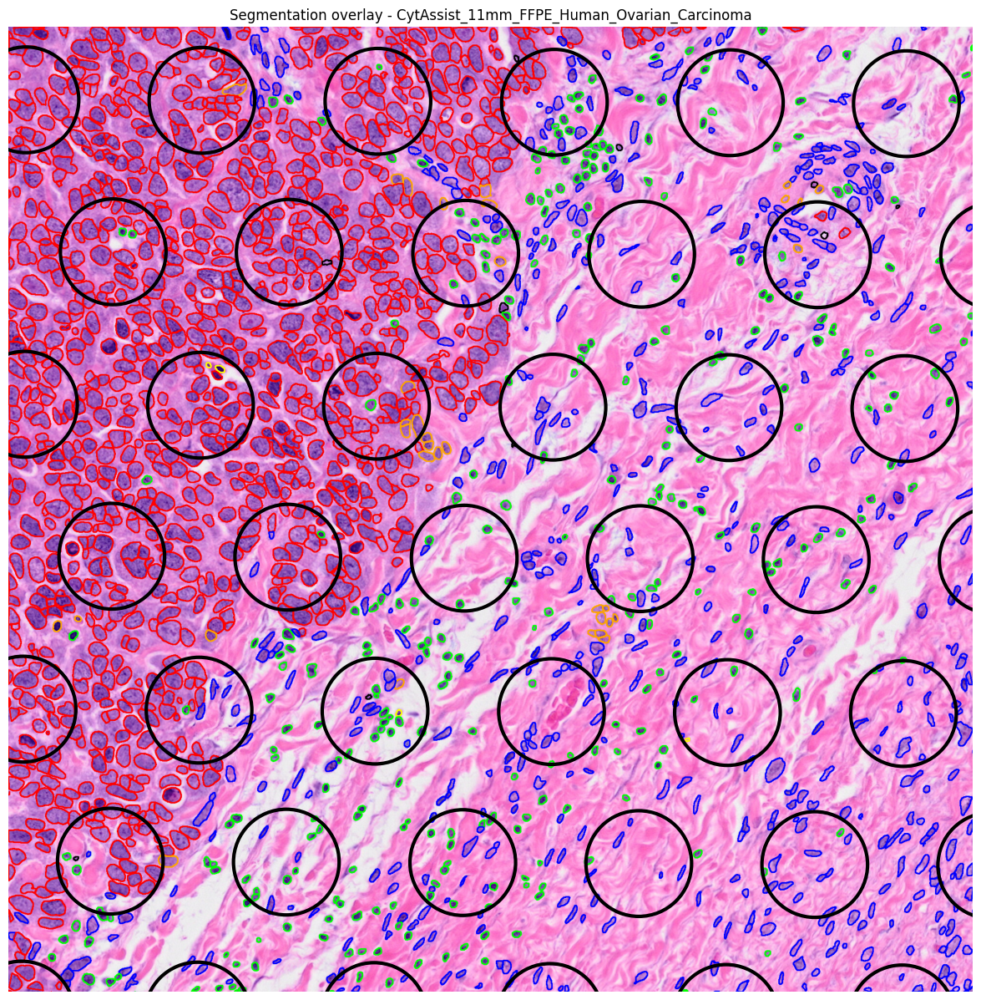

In [15]:
plotter.plot_seg(window, show_visium=True, draw_dot=False)

In [ ]:
from hedest.postseg import IntVisualizer

plotter_int = IntVisualizer(image_path, 
                            adata, 
                            adata_name, 
                            dict_cells=json_path, 
                            dict_types_colors=dict_types_colors)

Visium data found.


TIFFReadDirectory: Warning, Unknown field with tag 33560 (0x8318) encountered.


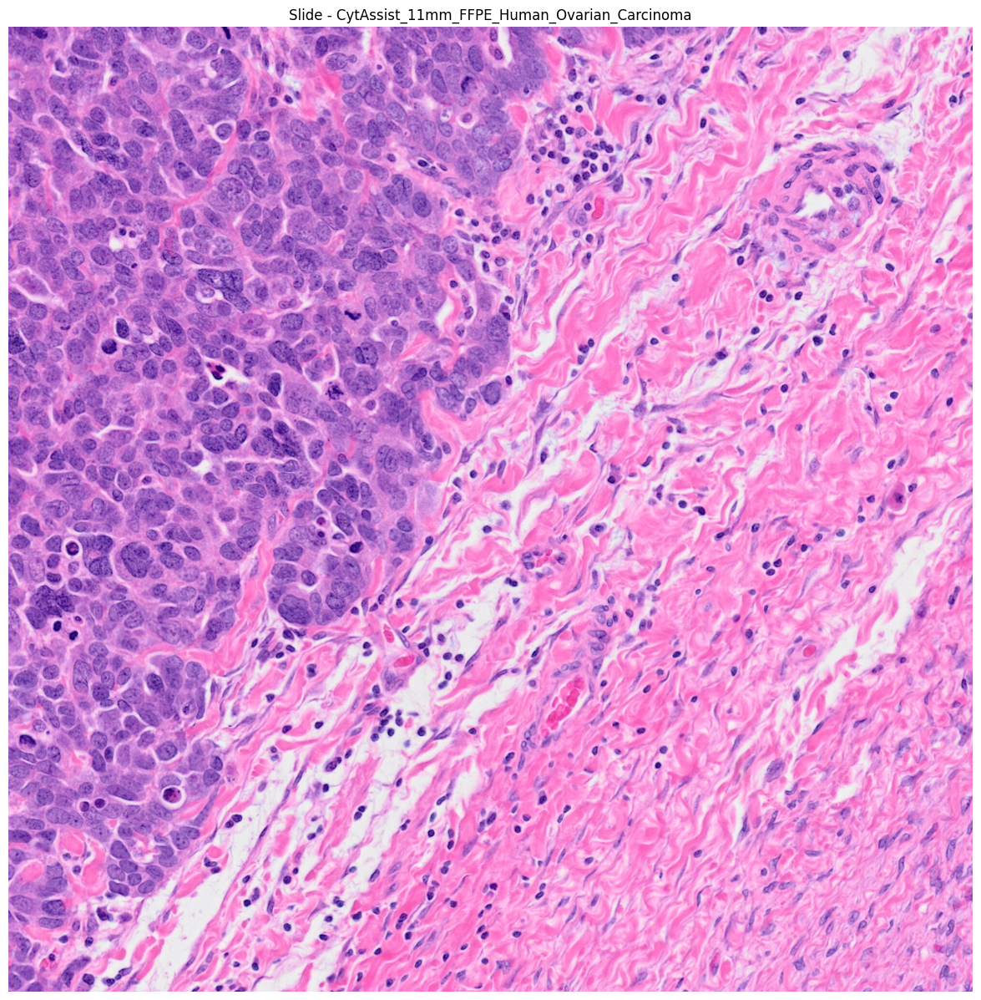

In [18]:
plotter_int.plot_slide(window, show_visium=False)

In [20]:
plotter_int.plot_seg(window, show_visium=False)

In [21]:
plotter_int.plot_specific_spot()

Randomly selected spot_id: GTGCAGGCAGGCCTCA-1


# Map cells to spots

In [41]:
# dict_cell2spot = map_cells_to_spots(adata, adata_name, json_path)

Mapping cells to spots: 100%|██████████| 352093/352093 [00:01<00:00, 221177.99it/s]


# Extract Tiles from HoverNet segmentation

In [ ]:
# level = 0
# size = (64, 64)
# dict_types = {0 : "nolabe", 
#               1 : "neopla", 
#               2 : "inflam", 
#               3 : "connec", 
#               4 : "necros", 
#               5 : "no-neo"}
# out_dir = "data/CytAssist_11mm_FFPE_Human_Ovarian_Carcinoma/img/"

# extract_tiles_hovernet(image_path, json_path, dict_types, out_dir, level, size)

100%|██████████| 352093/352093 [25:06<00:00, 233.76it/s] 
